In [1]:
from concurrent.futures import ThreadPoolExecutor
from IPython.display import Audio
from matplotlib import pyplot as plt
import os
from pathlib import Path
import torch
import torchaudio.transforms as T
from tqdm.notebook import tqdm
import pandas as pd
import geopandas as gpd
from functions.processing.retrieval import selectSubset
import re

from functions.dl.network_components import AudioToLogSpectrogram
from functions.processing.recordings import process_and_save_as_pt, add_white_noise, modulate_volume, random_cutout, pitch_warp, apply_augmentation_transforms, create_data_augmentation, get_noise_profile, denoise_data, random_timeshift, oversample, vertical_blackout, horizontal_blackout, speed_up, cut_off_edge, random_volume_change
from functions.processing.retrieval import loadPT

In [97]:
input_dir = Path("./AudioTensors")
audio_files = list(input_dir.glob("*.pt"))
tens = loadPT(audio_files[0])

In [81]:
Audio(tens.squeeze().numpy(), rate=16000)

In [99]:
Audio(add_white_noise(tens, 15).squeeze().numpy(), rate=16000)

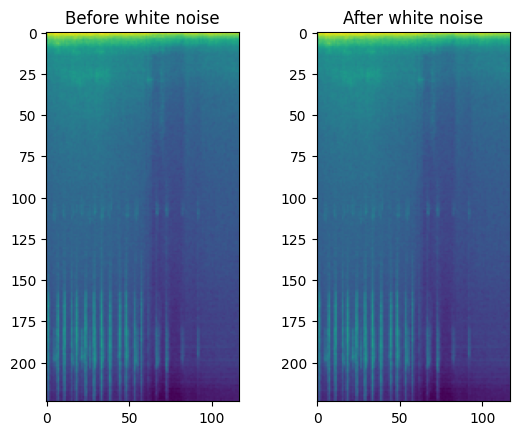

In [100]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
white_spec = atls(add_white_noise(tens, snr = 15).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before white noise")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After white noise")
ax[1].imshow(white_spec.squeeze(0).squeeze(0).to("cpu"))

In [104]:
atls = AudioToLogSpectrogram()

In [16]:
from torchaudio.functional import add_noise

In [87]:
def add_white_noise(signal, snr = 30):
    """
        snr: in db, use ~ 30 for low noise
    """
    signal = signal.unsqueeze(0)
    noise = torch.randn_like(signal)

    noisy_signal = add_noise(signal, noise, torch.tensor([snr]))
    
    return noisy_signal


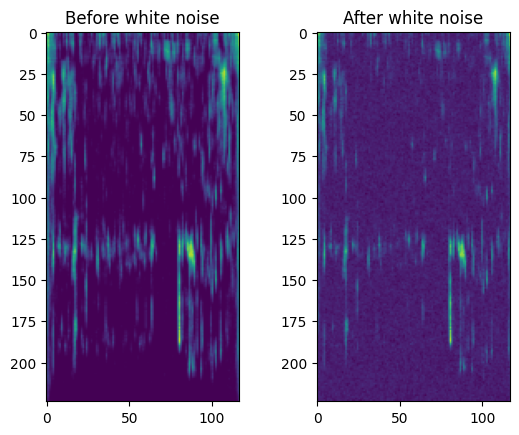

In [105]:
tens = loadPT("F:/Persönliches/Git/BioOTon/AudioTensors_denoised/22710584_audio_dn.pt")
spec = atls(loadPT("F:/Persönliches/Git/BioOTon/AudioTensors_denoised/22710584_audio_dn.pt").to("cpu")).squeeze(0).squeeze(0)
white_spec = atls(add_white_noise(tens, 15))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before white noise")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After white noise")
ax[1].imshow(white_spec.squeeze(0).squeeze(0).to("cpu"))

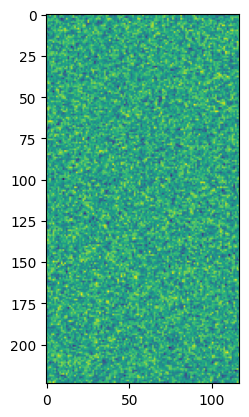

In [93]:
plt.imshow(atls(loadPT("F:\\Persönliches\\Git\\BioOTon\\augmented_data_denoised\\wn_22710584_audio_dn.pt")).squeeze(0).squeeze(0))

In [6]:
Audio(speed_up(tens, factor = 1.15).squeeze().numpy(), rate=16000)

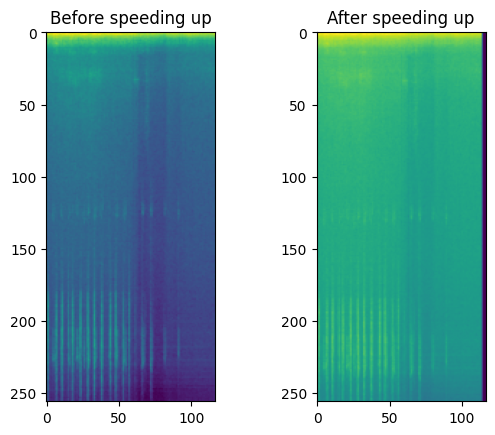

In [17]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
speed_spec = atls(speed_up(tens, factor = 1.025).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before speeding up")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After speeding up")
ax[1].imshow(speed_spec.squeeze(0).squeeze(0).to("cpu"))

In [8]:
# Not used, since the normalization of the spectrogram will make this obsolete
Audio(modulate_volume(tens, lower_gain = 0.001, upper_gain=5).squeeze().numpy(), rate=16000)

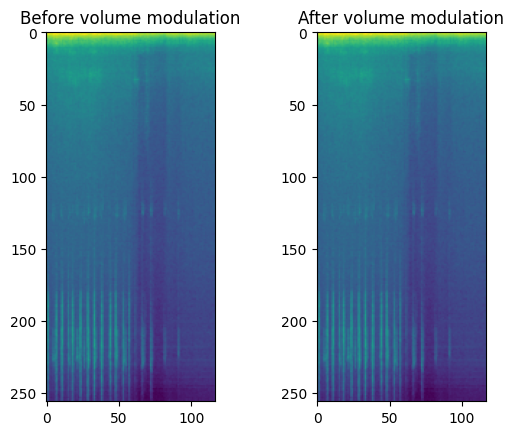

In [18]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
vol_spec = atls(modulate_volume(tens, lower_gain = 0.001, upper_gain=5).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before volume modulation")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After volume modulation")
ax[1].imshow(vol_spec.squeeze(0).squeeze(0).to("cpu"))

In [17]:
Audio(random_volume_change(tens, pct=.2).squeeze().numpy(), rate=16000)

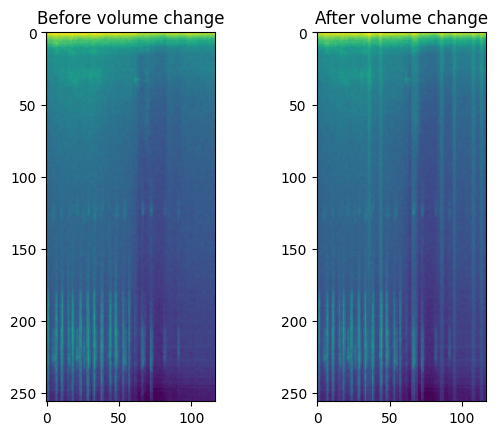

In [20]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
vol_spec = atls(random_volume_change(tens, pct=.15).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before volume change")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After volume change")
ax[1].imshow(vol_spec.squeeze(0).squeeze(0).to("cpu"))

In [35]:
Audio(random_cutout(tens, pct=.00005).squeeze().numpy(), rate=16000)

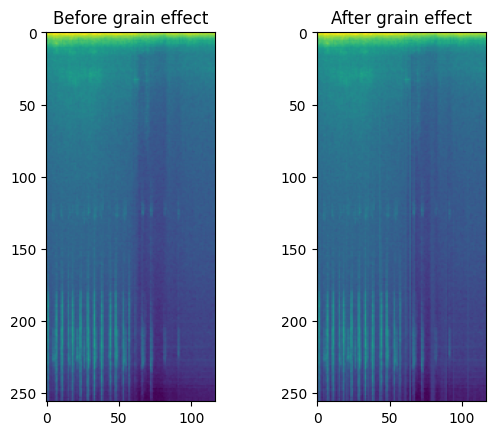

In [34]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
grain_spec = atls(random_cutout(tens, pct=.00005).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before grain effect")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After grain effect")
ax[1].imshow(grain_spec.squeeze(0).squeeze(0).to("cpu"))

In [36]:
Audio(pitch_warp(tens, sr_divisor=1.5).squeeze().numpy(), rate=16000)

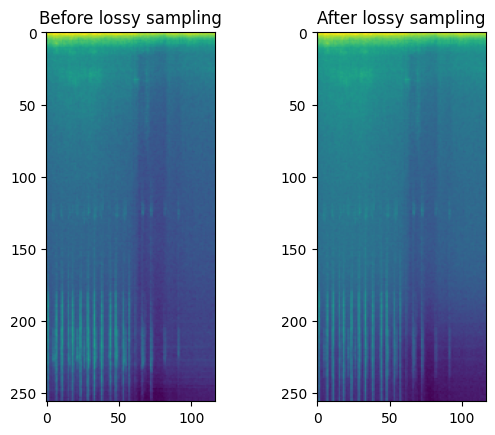

In [38]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
lossy_spec = atls(pitch_warp(tens, sr_divisor=1.15).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before lossy sampling")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After lossy sampling")
ax[1].imshow(lossy_spec.squeeze(0).squeeze(0).to("cpu"))

In [ ]:
Audio(random_timeshift(tens).squeeze().numpy(), rate=16000)

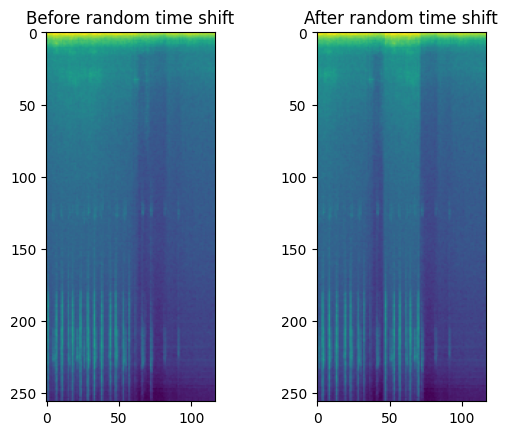

In [39]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
shift_spec = atls(random_timeshift(tens).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before random time shift")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After random time shift")
ax[1].imshow(shift_spec.squeeze(0).squeeze(0).to("cpu"))

In [19]:
Audio(oversample(tens).squeeze().numpy(), rate=16000)

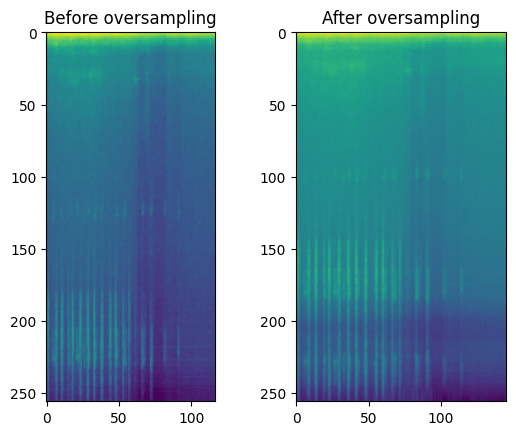

In [3]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
over_spec = atls(oversample(tens, new_freq=20000).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before oversampling")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After oversampling")
ax[1].imshow(over_spec.squeeze(0).squeeze(0).to("cpu"))

In [20]:
Audio(vertical_blackout(tens).squeeze().numpy(), rate=16000)

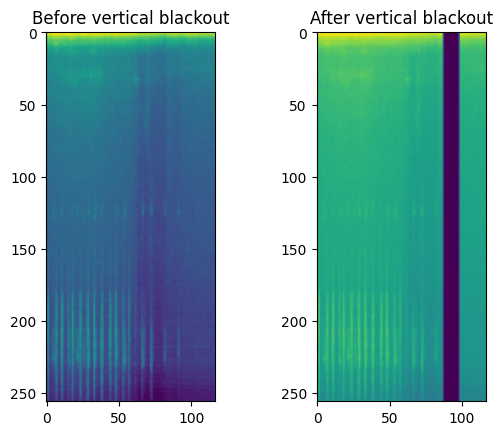

In [4]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
over_spec = atls(vertical_blackout(tens).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before vertical blackout")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After vertical blackout")
ax[1].imshow(over_spec.squeeze(0).squeeze(0).to("cpu"))

In [24]:
Audio(horizontal_blackout(tens.float(), 16000, 8000).squeeze().numpy(), rate=16000)

0.0005543532075536852


0.0005282873345236905


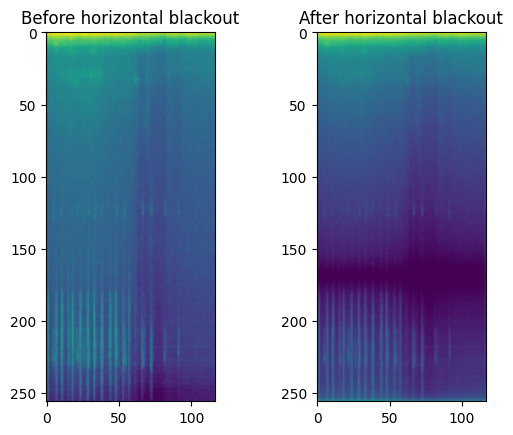

In [5]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
over_spec = atls(horizontal_blackout(tens.float(), 16000, 8000).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before horizontal blackout")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After horizontal blackout")
ax[1].imshow(over_spec.squeeze(0).squeeze(0).to("cpu"))

In [31]:
Audio(cut_off_edge(tens).squeeze().numpy(), rate=16000)

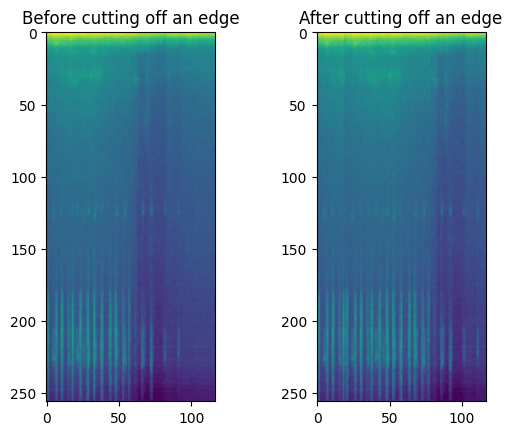

In [11]:
atls = AudioToLogSpectrogram().to("cuda")

spec = atls(tens.to("cuda"))
over_spec = atls(cut_off_edge(tens).to("cuda"))

fig, ax = plt.subplots(1,2)

ax[0].set_title("Before cutting off an edge")
ax[0].imshow(spec.squeeze(0).squeeze(0).to("cpu"))
ax[1].set_title("After cutting off an edge")
ax[1].imshow(over_spec.squeeze(0).squeeze(0).to("cpu"))

In [ ]:
apply_augmentation_transforms(tens, [modulate_volume, pitch_warp, add_white_noise])

In [ ]:
# --- Setup Paths ---
input_dir = Path("./AudioTensors")
output_dir = Path("./AudioTensors_data_augmentation")
output_dir.mkdir(exist_ok=True)

# Find all files
audio_files = list(input_dir.glob("*.pt"))

print(f"Total files to process: {len(audio_files)}")

# --- Execution ---

with ThreadPoolExecutor(max_workers=os.cpu_count()) as executor:
    # Use a list to hold the results so tqdm can track progress
    results = list(tqdm(
        executor.map(lambda f: create_data_augmentation(f, output_dir), audio_files), 
        total=len(audio_files),
        desc="Augmenting data."
    ))

print(f"Success: {sum(results)} | Failed: {len(results) - sum(results)}")

In [110]:
def augment_data_record(file_path, output_dir):
    tasks = [
        (lambda val: add_white_noise(val, snr = 20.0 ), "wn"),
        (lambda val: speed_up(val, factor = 1.15), "sp"),
        (lambda val: random_volume_change(val, pct=.15), "vc"),
        (lambda val: random_cutout(val, pct=.00005), "rc"),
        (lambda val: pitch_warp(val, sr_divisor=1.15), "pw"),
        (lambda val: random_timeshift(val), "rt"),
        (lambda val: oversample(val, new_freq=20000), "os"),
        (lambda val: vertical_blackout(val), "vb"),
        (lambda val: horizontal_blackout(val.float(), 16000, 8000), "hb"),
        (lambda val: cut_off_edge(val), "ce")
    ]
    try:
        wave = loadPT(file_path).bfloat16()
        for fun, suf in tasks:
            target_path = output_dir / (f"{suf}_{file_path.stem}.pt")

            # Skip the file already exists
            if target_path.exists():
                print(f"File {suf}_{file_path.stem}.pt already exists.")
                continue
            
            audio_tensor = fun(wave).bfloat16()
            print("Processed wave")
            # Save tensor
            torch.save(audio_tensor, target_path)
            del audio_tensor
        del wave   
        return True
    except Exception as e:
        print(e)
        return False

In [111]:
# Get all files in dawn and xeno dir
dawn_dir = Path("./AudioTensors_denoised")
xeno_dir = Path("./XenoCanto_denoised")

output_dir = Path("./augmented_data_denoised")
output_dir.mkdir(exist_ok=True)

dawn_files = list(dawn_dir.glob("*.pt"))
xeno_files = list(xeno_dir.glob("*.pt"))

audio_files = [*dawn_files, *xeno_files]

In [112]:
# Filter to only use classes that do not have as much data
wanted_oc = [
    # Closed off areas
    #  "112", #discontinuous urban fabric # Not used here since it already has roughly 50k points # subset.groupby("label").count()
    "221","222", "244", # Vineyards, Fruit tree and berry plantations (2/3 are trees), Agro-forestry
    "31", # Forest

    # Open areas
    "141", # green urban areas
    "211", "212", "23", "241", "242", "243", # arable land (non- / permanently irrigated), pastures, annual crops, complex cultivation, agriculture+natural vegetation 
    "32", # Shrub and herbaceous
    "41" # Inland wetlands
]

# open label table for dawn chorus
pframe_single = pd.read_parquet("points_single.parquet")
pframe_single["geometry"] = gpd.GeoSeries.from_wkb(pframe_single.geometry).buffer(200, cap_style='square')

# open label table for xeno-canto
xeno_frame_single = pd.read_parquet("xeno_points_single.parquet")
xeno_frame_single["geometry"] = gpd.GeoSeries.from_wkb(xeno_frame_single.geometry).buffer(200, cap_style='square')

# select subsets that contain only the labels above
dawn_subset = selectSubset(pframe_single, wanted_oc)
xeno_subset = selectSubset(xeno_frame_single, wanted_oc)
xeno_subset['id'] = xeno_subset['id'].astype(int)

# Remove the audio parts from the audio_files list to only get the id
cleaned_files = list(map(lambda f: int(str(f).replace("AudioTensors_denoised\\", "").replace("XenoCanto_denoised\\", "").split("_audio")[0]), audio_files))

# Match the subsets and the audio file ids
dawn_df = dawn_subset[dawn_subset.id.isin(cleaned_files)]
xeno_df = xeno_subset[xeno_subset.id.isin(cleaned_files)]

# combine to get a singular list
subset = pd.concat([dawn_df, xeno_df])


id_set = set(subset['id'].astype(str))

# Match the list with the audio files to get only the paths of files that are relevant
# this also matches the 10 recordings with more to their name, e.g., August-XX-XX-XX
filtered_audio_files = [
    p for p in audio_files 
    if (match := re.search(r'\d+', p.name)) and match.group(0) in id_set
]

C:\Users\mfher\AppData\Local\Temp\ipykernel_19080\1513767952.py:26: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  xeno_subset['id'] = xeno_subset['id'].astype(int)


In [ ]:
tasks = [
    (lambda val: add_white_noise(val, snr = 20.0), "wn"),
    (lambda val: speed_up(val, factor = 1.15), "sp"),
    (lambda val: random_volume_change(val, pct=.15), "vc"),
    (lambda val: random_cutout(val, pct=.00005), "rc"),
    (lambda val: pitch_warp(val, sr_divisor=1.15), "pw"),
    (lambda val: random_timeshift(val), "rt"),
    (lambda val: oversample(val, new_freq=20000), "os"),
    (lambda val: vertical_blackout(val), "vb"),
    (lambda val: horizontal_blackout(val.float(), 16000, 8000), "hb"),
    (lambda val: cut_off_edge(val), "ce")
    ]
files_to_process = []

for file_path in filtered_audio_files:
    exist_counter = 0
    for _, suf in tasks:
        target_path = output_dir / f"{suf}_{file_path.stem}.pt"
        if target_path.exists():
            exist_counter += 1
    
    if exist_counter < 10:
        files_to_process.append(file_path)

In [ ]:
# Use this if tensors are too large (this is single core and slower)
for file in files_to_process:
    augment_data_record(file, output_dir)

File wn_27861372_audio_dn.pt already exists.
File sp_27861372_audio_dn.pt already exists.
File vc_27861372_audio_dn.pt already exists.
File rc_27861372_audio_dn.pt already exists.
Processed wave
Processed wave
Processed wave
Processed wave
0.0005108792281189164
Processed wave
Processed wave
File wn_27861392_audio_dn.pt already exists.
File sp_27861392_audio_dn.pt already exists.
File vc_27861392_audio_dn.pt already exists.
File rc_27861392_audio_dn.pt already exists.
Processed wave
Processed wave
Processed wave
Processed wave
0.0005713364647954443
Processed wave
Processed wave
File wn_27861393_audio_dn.pt already exists.
File sp_27861393_audio_dn.pt already exists.
File vc_27861393_audio_dn.pt already exists.
File rc_27861393_audio_dn.pt already exists.
Processed wave
Processed wave
Processed wave
Processed wave
0.00045074395236229946
Processed wave
Processed wave
File wn_27861394_audio_dn.pt already exists.
File sp_27861394_audio_dn.pt already exists.
File vc_27861394_audio_dn.pt alre

In [115]:
print(f"Total files to process: {len(filtered_audio_files)}")

# --- Execution ---
# filtered_audio_files = files_to_process
with ThreadPoolExecutor(max_workers=os.cpu_count()-6) as executor:
    # Use a list to hold the results so tqdm can track progress
    results = list(tqdm(
        executor.map(lambda f: augment_data_record(f, output_dir), filtered_audio_files), 
        total=len(filtered_audio_files),
        desc="Augmenting data."
    ))


print(f"Success: {sum(results)} | Failed: {len(results) - sum(results)}")

Total files to process: 15754


Augmenting data.:   0%|          | 0/15754 [00:00<?, ?it/s]

Processed wave
Processed wave
Processed wave
Processed waveProcessed wave

Processed wave
File sp_19200999_audio_dn.pt already exists.
File vc_19200999_audio_dn.pt already exists.
File sp_19115260_audio_dn.pt already exists.
File sp_19205230_audio_dn.pt already exists.
File sp_19202771_audio_dn.pt already exists.
File rc_19200999_audio_dn.pt already exists.
File sp_19096975_audio_dn.pt already exists.
File vc_19115260_audio_dn.pt already exists.
File vc_19202771_audio_dn.pt already exists.
File vc_19205230_audio_dn.pt already exists.
File rc_19115260_audio_dn.pt already exists.
File pw_19200999_audio_dn.pt already exists.
File vc_19096975_audio_dn.pt already exists.
Processed wave
File sp_19203239_audio_dn.pt already exists.
File rc_19202771_audio_dn.pt already exists.
File rc_19205230_audio_dn.pt already exists.
File vc_19203239_audio_dn.pt already exists.
File rt_19200999_audio_dn.pt already exists.
File rc_19096975_audio_dn.pt already exists.
File rc_19203239_audio_dn.pt already exi

In [ ]:
augmented_dir = Path("./augmented_data_denoised")
xeno_points_dir = Path("./xeno_points_single.parquet")
dawn_points_dir = Path("./points_single.parquet")

dawn_points = pd.read_parquet(dawn_points_dir)
xeno_points = pd.read_parquet(xeno_points_dir)
xeno_points.id = xeno_points.id.astype(int)

augmented_files = list(augmented_dir.glob("*.pt"))

augmented_ids = [int(str(f).split("_")[-3]) for f in augmented_files]
augmented_points = pd.DataFrame({"id":augmented_ids})

adf = augmented_points.merge(xeno_points, how="left", left_on="id", right_on="id")

bdf = adf.merge(dawn_points, how="left", left_on="id", right_on="id")

bdf["label"] = bdf['label_x'].combine_first(bdf['label_y'])
bdf["geometry"] = bdf['geometry_x'].combine_first(bdf['geometry_y'])

bdf.drop(columns=["label_x", "label_y", "geometry_x", "geometry_y"], inplace=True)
# bdf.to_parquet("augmented_points_single.parquet")

In [106]:
pd.read_parquet("augmented_points_single.parquet")

,id,label,geometry
0,1000106,312,b'\x01\x01\x00\x00\x00\x8d\x02\xe1\xdcW\xd7NA\...
1,1000371,312,b'\x01\x01\x00\x00\x00\xf8=\xfb;\xbamPAkmD4quIA'
2,1001124,313,b'\x01\x01\x00\x00\x00\r?g\xbf\xfa\xc2OA\x1e\x...
3,1001127,313,b'\x01\x01\x00\x00\x00\xdeiL\x0c\n\xc3OA:\xfa\...
4,100114,231,b'\x01\x01\x00\x00\x00\xa3\x18|\xd0\xdbCPA\xb4...
...,...,...,...
157363,999439,322,b'\x01\x01\x00\x00\x00\xc8\xf7X\x98rKQA\xe4\xb...
157364,999547,312,b'\x01\x01\x00\x00\x00\xf9\xf1<\xae\xaemPA\xcc...
157365,99984,313,b'\x01\x01\x00\x00\x00\x16\xa1\xc9\x9f\xdf\xbf...
157366,99986,313,b'\x01\x01\x00\x00\x00\x16\xa1\xc9\x9f\xdf\xbf...
